## Yashvi Bhadania - OULIERS DETECTION AND HANDLING

## Outlier Detection Methods Implemented

I have implemented the following outlier detection techniques:

### 1. Statistical Methods
- **Z-Score**: Identifies outliers based on standard deviations from the mean.
- **Interquartile Range (IQR) & Box Plot for Visualizing**: Detects outliers using quartiles and the IQR rule.
- **Pairplot**: To visualize outliers in all field combinations

### 2. Machine Learning-Based Method
- **DBSCAN (Density-Based Spatial Clustering of Applications with Noise)**: Clusters data points and identifies low-density points as outliers.

### 3. Distance-Based Method
- **K-Nearest Neighbors (KNN)**: Detects outliers by measuring the distance from a point to its k-nearest neighbors.


In [6]:
# https://www.kaggle.com/code/csanskriti/amazon-sales-data-analysis/input?select=Sale+Report.csv
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
import plotly.express as px
from sklearn.neighbors import LocalOutlierFactor
from sklearn.cluster import DBSCAN
plt.style.use('dark_background')

In [7]:
data1 = pd.read_csv('Amazon Sale Report.csv')
data1.head()

/var/folders/nk/hgf7_brn39q9t4srskbh3vjr0000gn/T/ipykernel_20797/2925354618.py:1: DtypeWarning: Columns (23) have mixed types. Specify dtype option on import or set low_memory=False.
  data1 = pd.read_csv('Amazon Sale Report.csv')


,index,Order ID,Date,Status,Fulfilment,Sales Channel,ship-service-level,Style,SKU,Category,...,currency,Amount,ship-city,ship-state,ship-postal-code,ship-country,promotion-ids,B2B,fulfilled-by,Unnamed: 22
0,0,405-8078784-5731545,04-30-22,Cancelled,Merchant,Amazon.in,Standard,SET389,SET389-KR-NP-S,Set,...,INR,647.62,MUMBAI,MAHARASHTRA,400081.0,IN,NaN,False,Easy Ship,NaN
1,1,171-9198151-1101146,04-30-22,Shipped - Delivered to Buyer,Merchant,Amazon.in,Standard,JNE3781,JNE3781-KR-XXXL,kurta,...,INR,406.00,BENGALURU,KARNATAKA,560085.0,IN,Amazon PLCC Free-Financing Universal Merchant ...,False,Easy Ship,NaN
2,2,404-0687676-7273146,04-30-22,Shipped,Amazon,Amazon.in,Expedited,JNE3371,JNE3371-KR-XL,kurta,...,INR,329.00,NAVI MUMBAI,MAHARASHTRA,410210.0,IN,IN Core Free Shipping 2015/04/08 23-48-5-108,True,NaN,NaN
3,3,403-9615377-8133951,04-30-22,Cancelled,Merchant,Amazon.in,Standard,J0341,J0341-DR-L,Western Dress,...,INR,753.33,PUDUCHERRY,PUDUCHERRY,605008.0,IN,NaN,False,Easy Ship,NaN
4,4,407-1069790-7240320,04-30-22,Shipped,Amazon,Amazon.in,Expedited,JNE3671,JNE3671-TU-XXXL,Top,...,INR,574.00,CHENNAI,TAMIL NADU,600073.0,IN,NaN,False,NaN,NaN


In [8]:
data1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 128975 entries, 0 to 128974
Data columns (total 24 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   index               128975 non-null  int64  
 1   Order ID            128975 non-null  object 
 2   Date                128975 non-null  object 
 3   Status              128975 non-null  object 
 4   Fulfilment          128975 non-null  object 
 5   Sales Channel       128975 non-null  object 
 6   ship-service-level  128975 non-null  object 
 7   Style               128975 non-null  object 
 8   SKU                 128975 non-null  object 
 9   Category            128975 non-null  object 
 10  Size                128975 non-null  object 
 11  ASIN                128975 non-null  object 
 12  Courier Status      122103 non-null  object 
 13  Qty                 128975 non-null  int64  
 14  currency            121180 non-null  object 
 15  Amount              121180 non-nul

In [9]:
data1.describe()

,index,Qty,Amount,ship-postal-code
count,128975.000000,128975.000000,121180.000000,128942.000000
mean,64487.000000,0.904431,648.561465,463966.236509
std,37232.019822,0.313354,281.211687,191476.764941
min,0.000000,0.000000,0.000000,110001.000000
25%,32243.500000,1.000000,449.000000,382421.000000
50%,64487.000000,1.000000,605.000000,500033.000000
75%,96730.500000,1.000000,788.000000,600024.000000
max,128974.000000,15.000000,5584.000000,989898.000000


In [10]:
# Select numerical columns for outlier analysis
numeric_cols = data1.select_dtypes(include=['number']).columns

# Create a copy of the dataset for modifications
df = data1.copy()

## 1. STATISTICAL METHOD A: Z-score

	•	Outliers are detected using the standard deviation.
	•	Example: Values beyond ±2 standard deviations are considered outliers.

In [20]:
# 1️⃣ **Using Z-score method**
z_scores = np.abs(stats.zscore(df[numeric_cols]))  # Compute Z-scores
threshold = 3  # Common threshold for outliers
outliers_z = (z_scores > threshold)

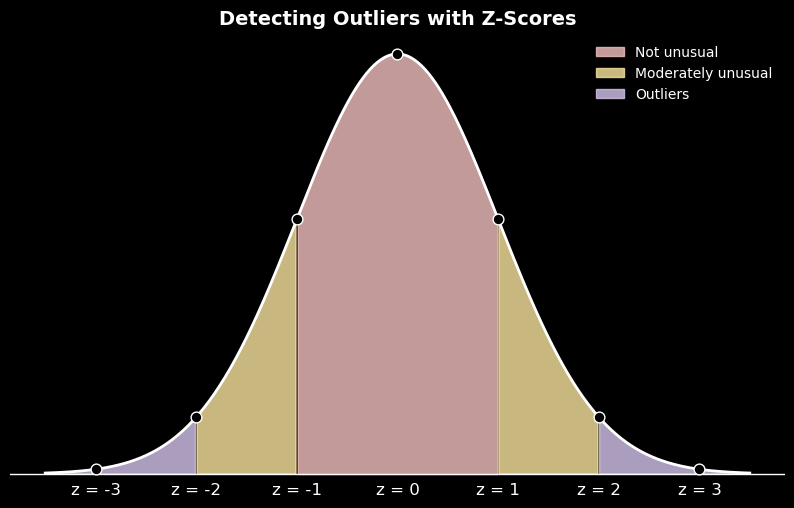

In [19]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import norm

# Set dark theme
plt.style.use("dark_background")

# Generate x values
x = np.linspace(-3.5, 3.5, 400)
y = norm.pdf(x, 0, 1)  # Standard normal distribution

# Define color zones
colors = {
    "not_unusual": "#F4C2C2",  # Light pastel red
    "moderate": "#FBE7A1",  # Light pastel yellow
    "outliers": "#D7C6EE"  # Light pastel purple
}

# Create plot
fig, ax = plt.subplots(figsize=(10, 6))

# Fill regions
ax.fill_between(x, y, where=(x >= -1) & (x <= 1), color=colors["not_unusual"], alpha=0.8, label="Not unusual")
ax.fill_between(x, y, where=((x >= -2) & (x < -1)) | ((x > 1) & (x <= 2)), color=colors["moderate"], alpha=0.8, label="Moderately unusual")
ax.fill_between(x, y, where=(x <= -2) | (x >= 2), color=colors["outliers"], alpha=0.8, label="Outliers")

# Plot normal curve
ax.plot(x, y, color="white", linewidth=2)

# Mark z-scores
z_scores = [-3, -2, -1, 0, 1, 2, 3]
for z in z_scores:
    ax.scatter(z, norm.pdf(z, 0, 1), color="black", s=60, edgecolors="white", zorder=3)
    ax.text(z, -0.02, f"z = {z}", color="white", fontsize=12, ha="center")

# Add labels
ax.set_title("Detecting Outliers with Z-Scores", fontsize=14, fontweight="bold", color="white")
ax.axhline(0, color="white", linewidth=1)
ax.legend(loc="upper right", fontsize=10, frameon=False)

# Remove axes
ax.set_xticks([])
ax.set_yticks([])
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)
ax.spines["left"].set_visible(False)
ax.spines["bottom"].set_visible(False)

# Show plot
plt.show()

## 1. STATISTICAL METHOD B:  Interquartile Range (IQR) & Box Plot Visualization

In [ ]:
# 2️⃣ **Using IQR (Interquartile Range)**
Q1 = df[numeric_cols].quantile(0.25)
Q3 = df[numeric_cols].quantile(0.75)
IQR = Q3 - Q1
outliers_iqr = ((df[numeric_cols] < (Q1 - 1.5 * IQR)) | (df[numeric_cols] > (Q3 + 1.5 * IQR)))

In [ ]:
# --------------------------------------------
# 📌 Interactive Boxplot (Plotly)
# --------------------------------------------

fig = px.box(df, y=numeric_cols, title="Interactive Boxplot Before Handling Outliers")
fig.show()

In [14]:
# --------------------------------------------
# 📌 Outlier Handling Techniques
# --------------------------------------------

# 🟢 1. **Removing Outliers (Using IQR method)**
df_cleaned = df[~outliers_iqr.any(axis=1)]

# 🟢 2. **Replacing Outliers with Mean**
df_mean = df.copy()
for col in numeric_cols:
    mean_value = df_mean[col].mean()
    df_mean[col] = np.where(outliers_iqr[col], mean_value, df_mean[col])

# 🟢 3. **Replacing Outliers with Median**
df_median = df.copy()
for col in numeric_cols:
    median_value = df_median[col].median()
    df_median[col] = np.where(outliers_iqr[col], median_value, df_median[col])

# 🟢 4. **Winsorization (Capping extreme values)**
from scipy.stats.mstats import winsorize

df_winsorized = df.copy()
for col in numeric_cols:
    df_winsorized[col] = winsorize(df[col], limits=[0.05, 0.05])  # Capping at 5% on both ends


In [15]:
# --------------------------------------------
# 📌 Visualization After Handling Outliers
# --------------------------------------------

# # Boxplot after handling outliers (Median Replacement)
# plt.figure(figsize=(12, 6))
# sns.boxplot(data=df_median[numeric_cols])
# plt.title('Box Plot After Outlier Handling (Median Replacement)')
# plt.xticks(rotation=45)
# plt.show()

import plotly.express as px

# Interactive Boxplot After Handling Outliers (Median Replacement)
fig = px.box(df_median, y=numeric_cols, title="Interactive Box Plot After Outlier Handling (Median Replacement)")

# Show the interactive plot
fig.show()

## 1. STATISTICAL METHOD C: Pairplot

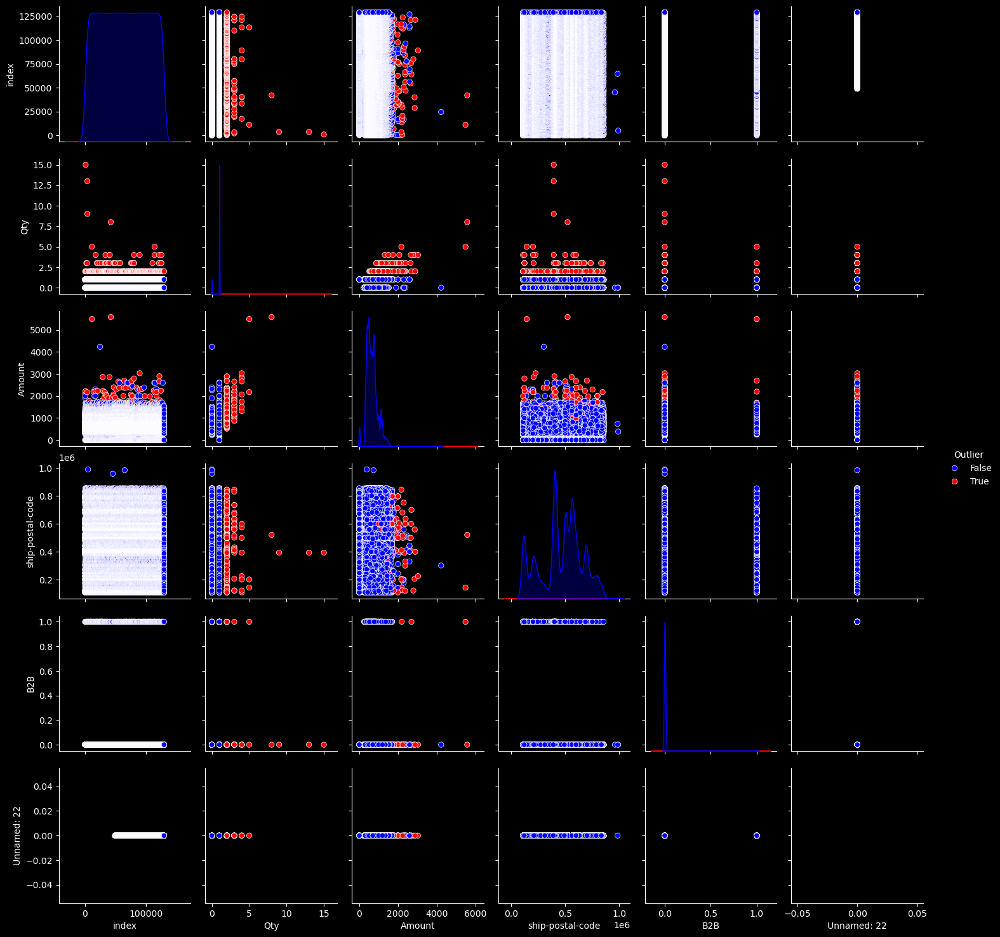

In [ ]:
# --------------------------------------------
# 📌 Pairplot with Outlier Highlighting
# --------------------------------------------

# Add an 'Outlier' column based on Z-score
df['Outlier'] = np.any(np.abs(stats.zscore(df[numeric_cols])) > 3, axis=1)
sns.pairplot(df, hue='Outlier', diag_kind='kde', palette={False: "blue", True: "red"})
plt.show()

## 2. MACHINE LEARNING-BASED METHOD: DBSCAN (Density-Based Spatial Clustering of Applications with Noise)


/var/folders/nk/hgf7_brn39q9t4srskbh3vjr0000gn/T/ipykernel_20797/3589594579.py:40: UserWarning:

The palette list has more values (10) than needed (6), which may not be intended.



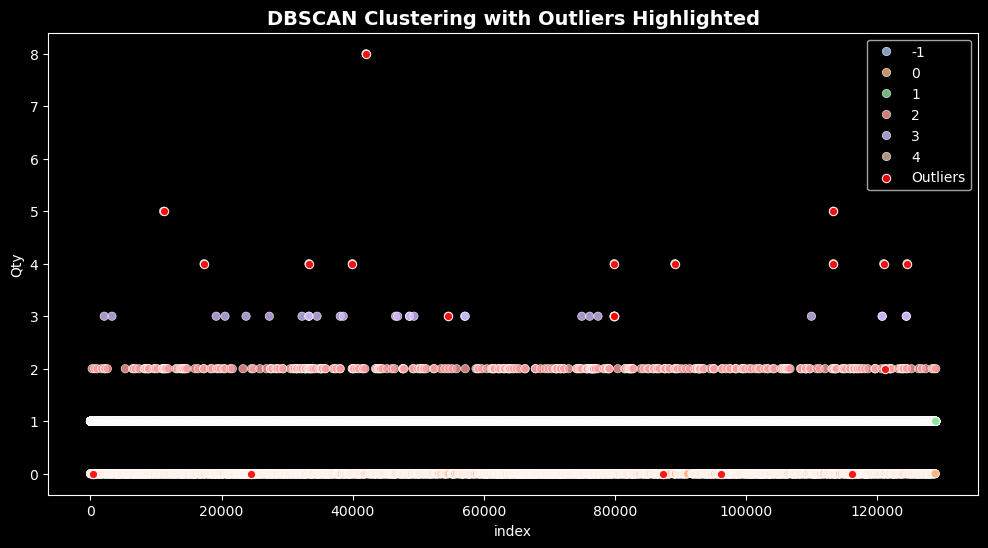

In [16]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler

# Enable dark mode
plt.style.use("dark_background")

# Load dataset with proper data type handling
df = pd.read_csv("Amazon Sale Report.csv", low_memory=False)

# Select only numeric columns & drop NaNs
numeric_df = df.select_dtypes(include=[np.number]).dropna()

# Standardize features
scaler = StandardScaler()
scaled_features = scaler.fit_transform(numeric_df)

# Apply DBSCAN clustering
dbscan = DBSCAN(eps=1.5, min_samples=5)
labels = dbscan.fit_predict(scaled_features)

# Add cluster labels
numeric_df = numeric_df.iloc[:len(labels)].copy()  # Ensure indices match
numeric_df["Cluster"] = labels

# Identify outliers (-1 cluster)
outliers = numeric_df[numeric_df["Cluster"] == -1]
inliers = numeric_df[numeric_df["Cluster"] != -1]

# Define pastel color palette
pastel_palette = sns.color_palette("pastel", as_cmap=True)

# Plot DBSCAN clustering results
fig, ax = plt.subplots(figsize=(12, 6))

# Scatter plot with light pastel colors
sns.scatterplot(
    x=numeric_df.iloc[:, 0], y=numeric_df.iloc[:, 1], hue=numeric_df["Cluster"], 
    palette=pastel_palette, alpha=0.8, edgecolors="white", linewidth=0.5
)

# Highlight outliers
sns.scatterplot(
    x=outliers.iloc[:, 0], y=outliers.iloc[:, 1], color="red", label="Outliers", 
    edgecolors="white", linewidth=0.8, alpha=0.9
)

plt.title("DBSCAN Clustering with Outliers Highlighted", fontsize=14, fontweight="bold")
plt.legend()
plt.show()

/var/folders/nk/hgf7_brn39q9t4srskbh3vjr0000gn/T/ipykernel_20797/3041841560.py:8: UserWarning:

The palette list has more values (10) than needed (5), which may not be intended.



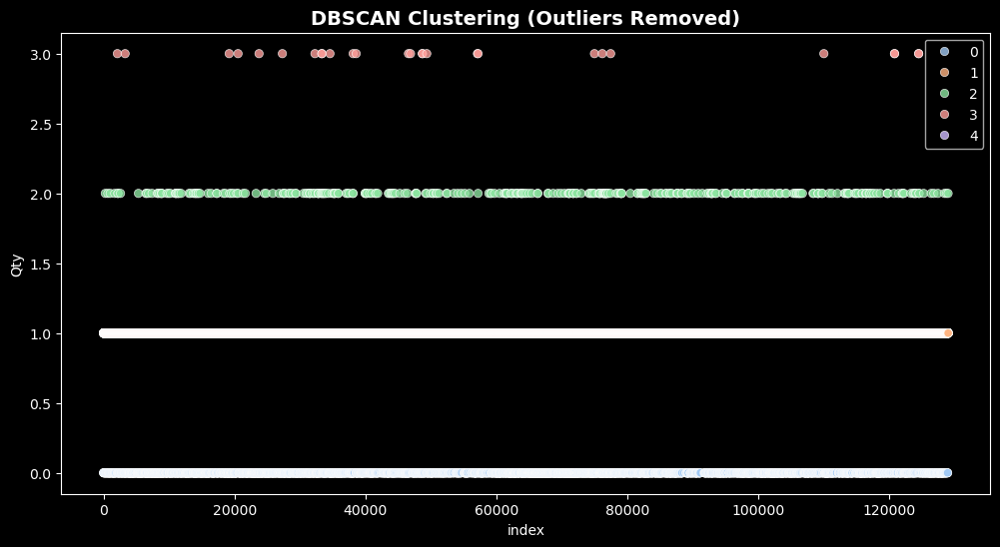

In [17]:
# Remove outliers (Cluster -1)
cleaned_df = numeric_df[numeric_df["Cluster"] != -1].copy()

# Plot cleaned data without outliers
fig, ax = plt.subplots(figsize=(12, 6))

# Scatter plot with pastel colors
sns.scatterplot(
    x=cleaned_df.iloc[:, 0], y=cleaned_df.iloc[:, 1], hue=cleaned_df["Cluster"], 
    palette=pastel_palette, alpha=0.8, edgecolors="white", linewidth=0.5
)

plt.title("DBSCAN Clustering (Outliers Removed)", fontsize=14, fontweight="bold")
plt.legend()
plt.show()

## 3. DISTANCE-BASED METHOD: K-Nearest Neighbors (KNN)

**Winsorization (capping):**
- **Replace extreme values with the nearest valid threshold.**
- **Example: Replace values above 99th percentile with the 99th percentile itself.**


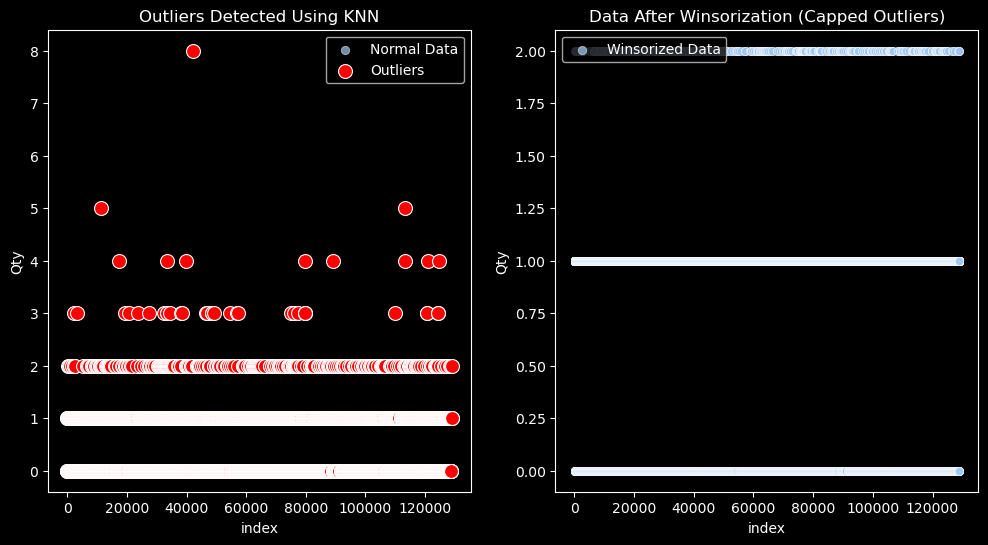

In [23]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.neighbors import NearestNeighbors
from sklearn.preprocessing import StandardScaler
from scipy.stats.mstats import winsorize

# Load dataset
df = pd.read_csv("Amazon Sale Report.csv", low_memory=False)

# Select only numeric columns & drop NaNs
numeric_df = df.select_dtypes(include=[np.number]).dropna()

# Standardize features
scaler = StandardScaler()
scaled_features = scaler.fit_transform(numeric_df)

# KNN-based Outlier Detection (using distances from 5th nearest neighbor)
k = 5
nbrs = NearestNeighbors(n_neighbors=k)
nbrs.fit(scaled_features)
distances, _ = nbrs.kneighbors(scaled_features)

# Compute the outlier threshold (95th percentile of 5th nearest neighbor distance)
threshold = np.percentile(distances[:, -1], 95)
outliers_mask = distances[:, -1] > threshold

# Split outliers and normal data
outliers = numeric_df[outliers_mask]
cleaned_df = numeric_df[~outliers_mask]

# Dark theme for visualization
plt.style.use("dark_background")
sns.set_palette("pastel")

# Plot before handling outliers
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
sns.scatterplot(x=numeric_df.iloc[:, 0], y=numeric_df.iloc[:, 1], alpha=0.7, label="Normal Data")
sns.scatterplot(x=outliers.iloc[:, 0], y=outliers.iloc[:, 1], color="red", label="Outliers", edgecolor="white", s=100)
plt.title("Outliers Detected Using KNN")
plt.legend()

# Winsorization: Cap extreme values
winsorized_data = numeric_df.apply(lambda x: winsorize(x, limits=[0.001, 0.001]) if np.issubdtype(x.dtype, np.number) else x)

# Plot after handling outliers
plt.subplot(1, 2, 2)
sns.scatterplot(x=winsorized_data.iloc[:, 0], y=winsorized_data.iloc[:, 1], alpha=0.7, label="Winsorized Data", edgecolor="white")
plt.title("Data After Winsorization (Capped Outliers)")
plt.legend()

plt.show()

## Conclusion  

In this notebook, I explored various outlier detection techniques, including statistical, machine learning-based, and distance-based methods. The **Z-Score** and **IQR** methods provided a simple yet effective approach to identifying extreme values based on statistical properties. **Pairplots** helped in visually analyzing potential outliers across different feature combinations.  

On the other hand, **DBSCAN** leveraged density-based clustering to separate noise from actual data points, making it effective for detecting outliers in non-uniform distributions. Similarly, **KNN** measured distances to identify anomalous points based on their proximity to neighboring data.  

For handling outliers, I implemented two approaches:  
1. **Dropping Outliers**: This method is straightforward but can lead to data loss, especially if outliers are numerous.  
2. **Winsorization**: This technique replaces extreme values with less extreme ones, making it more suitable when dealing with many outliers while preserving the dataset size.  

Each method has its strengths and limitations, and the choice of technique depends on the dataset characteristics and the specific use case. By combining these approaches, a more comprehensive and robust outlier detection and handling strategy can be achieved, leading to improved data quality and better downstream analysis.